In [35]:
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
from scipy import ndimage, misc
from scipy.misc import imread
import numpy as np
import glob
import os
import sys
from skimage import io, color, filters, feature, restoration

In [2]:
import sys
sys.path.append("..")

In [3]:
from src.standardizer import Standardizer
from src.imageData_generator import ImageGenerator

In [31]:
print('Loading model')
model_path = 'models/models/CNN_E100_Batch10_Filters64_Neurons64_Actrelu_Layers_3.h5'
model = load_model(model_path)

print('Loading resized images')
resized_imgs = glob.glob('data/medium/*')



Loading model
Loading resized images


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: Non-string object detected for the array ordering. Please pass in 'C', 'F', 'A', or 'K' instead
  
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  after removing the cwd from sys.path.


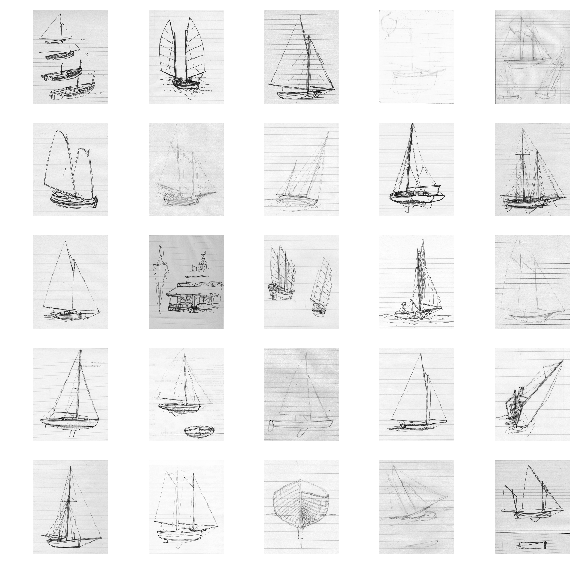

In [46]:
fig, ax = plt.subplots(5, 5, figsize=(10, 10))
for i, a in enumerate(ax.flatten(i)):
    a.set_axis_off()
    a.imshow(imread(resized_imgs[i], mode='L'), cmap='gray')

In [5]:
print('Subset the images that we want, the ones we trained the model on')
img_list = [164, 202, 425, 345, 139, 72, 311, 363, 403, 509, 362, 257, 175, 203, 47, 183, 0, 297, 34, 8, 320, 197, 293, 450, 215, 28, 74]
img_subset = []
for img in resized_imgs:
    img_idx = int(img.split('/')[2].split('_')[0])
    if img_idx in img_list:
        img_subset.append(img)

print('Standardize the images')
standardizer_subset = Standardizer(img_subset, resized_imgs[3])

print('Select the image we want to scrub')
bin_image = standardizer_subset.binarized_images[20]
grey_image = standardizer_subset.greyscale_image_list[20]
img_name = standardizer_subset.image_list[20].split('/')[2].split('.')[0]
print(img_name)

Subset the images that we want, the ones we trained the model on
Standardize the images
Select the image we want to scrub
320_img


In [6]:
images = ImageGenerator(bin_image, grey_image, img_name)
images.pad(15, 200)
gray = images.gray_padded_image

In [28]:
def plot_frame(zoom, row_index, col_index, size, prediction):
    masked_window = np.random.random((zoom.shape[0],zoom.shape[1]))
    masked_window[row_index:row_index+size, col_index:col_index+size] = 1
    masked_window = np.ma.masked_where(masked_window != 1, masked_window)

    masked_pixel = np.random.random((zoom[row_index:row_index+size, col_index:col_index+size].shape[0],zoom[row_index:row_index+size, col_index:col_index+size].shape[1]))
    masked_pixel[15,15] = 1
    masked_pixel = np.ma.masked_where(masked_pixel != 1, masked_pixel)

    masked_pixel1 = np.random.random((zoom[row_index:row_index+size, col_index:col_index+size].shape[0],zoom[row_index:row_index+size, col_index:col_index+size].shape[1]))
    masked_pixel1[8:23, 15] = 1
    masked_pixel1 = np.ma.masked_where(masked_pixel1 != 1, masked_pixel1)
    
    window = zoom[row_index:row_index+size, col_index:col_index+size]
    colored_percentage = np.count_nonzero(window==0)/(30**2)
    pixel_value = window[15, 15]
    window_sobel = ndimage.sobel(window, axis=0)
    above_area = np.mean(window_sobel[8:16, 15])
    below_area = np.mean(window_sobel[16:23, 15])
    sobel_value = window_sobel[15, 15]
    
    if prediction > 0.55:
        label = 'Line'
    else:
        label = 'Drawing'
    # Overlay the two images
    fig, ax = plt.subplots(1, 2)
    ax.ravel()
    ax[0].imshow(zoom, cmap='gray')
    ax[0].imshow(masked_window, cmap='prism', interpolation='none')
    # ax[0].imshow(masked_pixel, cmap=cm.jet, interpolation='none')
    ax[1].imshow(window, cmap='gray')
    ax[1].imshow(masked_pixel, cmap='prism', interpolation='none')
    ax[1].set_title(label, fontsize=20)
    fig.savefig('results/gifs/{}_{}.png'.format(row_index, col_index))
   
    
#     return above_area, below_area, colored_percentage

In [29]:
def demo_gif(row):
    for i in range(400):
        window = gray[row: row+30, i: i+30]
        X = window.reshape(-1, 30, 30, 1)
        prediction = model.predict(X)[0][0]
        plot_frame(gray, row, i, 30, prediction)
        plt.show()


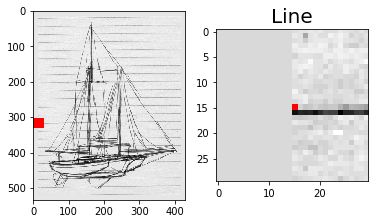

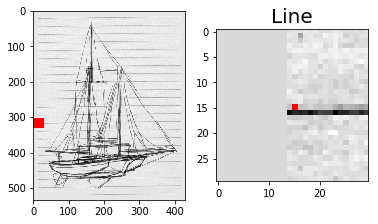

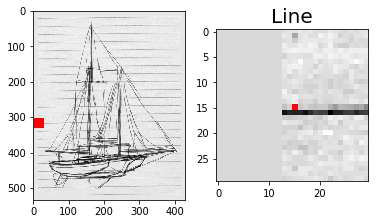

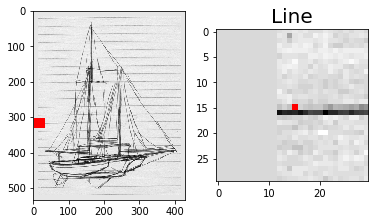

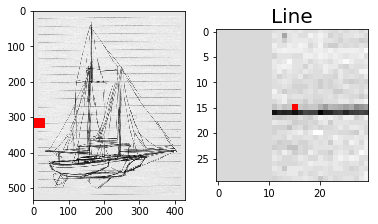

...

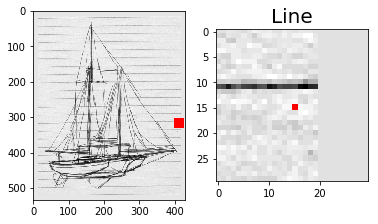

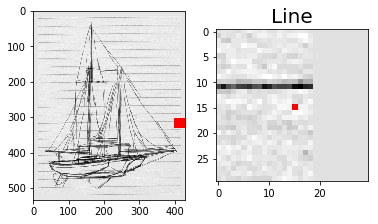

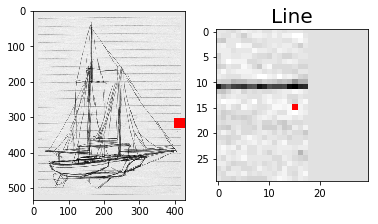

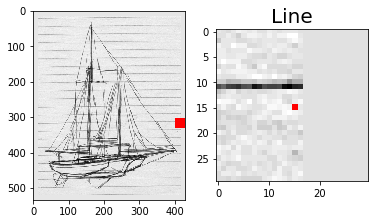

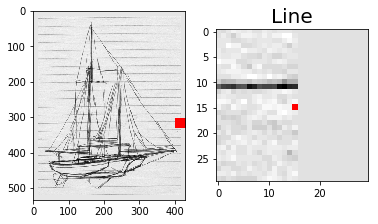

In [30]:
demo_gif(301)

1.0